In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import plotly.graph_objects as go
import xgboost as xgb

from catboost import CatBoostRegressor
from datetime import timedelta  
from lightgbm import LGBMRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

In [2]:
import time

In [3]:
os.getcwd()

'C:\\Users\\SMARTI25\\Dropbox\\TFG\\tfg-sb-meal-delivery-prediction\\shiny\\app\\notebooks'

In [4]:
os.chdir('../')

In [5]:
from src.model.xgboost_model import preprocess_data, train_xgboost_model

In [6]:
def get_predictions(model, df, date_index):
	preds = model.predict(df)
	preds = np.exp(preds)
	preds = preds.rename(columns={0 : 'num_orders'})
	
	preds = pd.DataFrame(preds)
	preds.index = date_index
	
	return preds

In [7]:
def calculate_prediction(models):
	result = pd.concat(models)
	result = result.rename(columns={0 : 'orders'})
	result = result.groupby('date').agg('mean')
	
	return result

In [8]:
df_train = pd.read_csv('./data/processed/train.csv', sep = ';', decimal=',')

In [9]:
df_train.head()

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders,city_code,region_code,center_type,op_area,category,cuisine,date
0,1379560,1,55,1885,136.83,152.29,0,0,177,647,56,TYPE_C,2.0,Beverages,Thai,2017-01-08
1,1466964,1,55,1993,136.83,135.83,0,0,270,647,56,TYPE_C,2.0,Beverages,Thai,2017-01-08
2,1346989,1,55,2539,134.86,135.86,0,0,189,647,56,TYPE_C,2.0,Beverages,Thai,2017-01-08
3,1338232,1,55,2139,339.50,437.53,0,0,54,647,56,TYPE_C,2.0,Beverages,Indian,2017-01-08
4,1448490,1,55,2631,243.50,242.50,0,0,40,647,56,TYPE_C,2.0,Beverages,Indian,2017-01-08


In [10]:
center_id = 10
meal_id = 1062

In [11]:
df_train_processed = preprocess_data(df_train, center_id, meal_id)

DF_PROCESSED: 145


C:\Users\SMARTI25\AppData\Local\Continuum\anaconda3\lib\site-packages\pandas\core\generic.py:5165: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SMARTI25\Dropbox\TFG\tfg-sb-meal-delivery-prediction\shiny\app\src\model\xgboost_model.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SMARTI25\Dropbox\TFG\tfg-sb-meal-delivery-prediction\shiny\app\src\model\xgboost_model.py:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

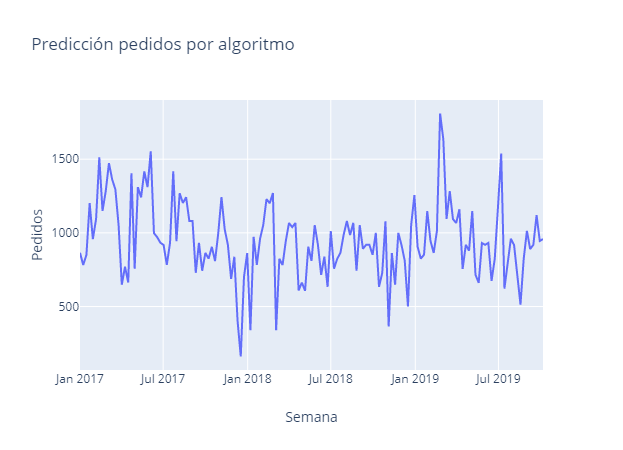

In [12]:
charts = [
	go.Scatter(
		x = df_train_processed.index,
		y = df_train_processed.num_orders,

	)
]

fig = go.Figure(
	data = charts,
	layout = go.Layout(
		title = 'Predicción pedidos por algoritmo',
		xaxis_title = 'Semana',
		yaxis_title = 'Pedidos'
	)
)

fig

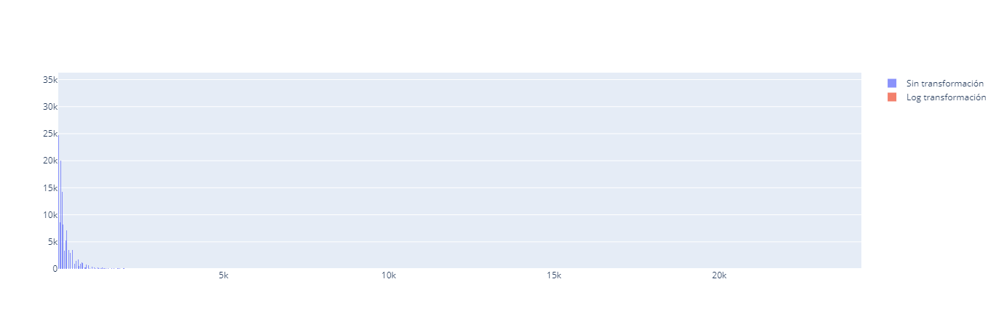

In [40]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=df_train.num_orders, name = 'Sin transformación'))
fig.add_trace(go.Histogram(x=np.log1p(df_train.num_orders), name = 'Log transformación'))

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

In [46]:
df_plot = df_train[['id', 'num_orders']]

In [47]:
df_plot['num_orders_log'] = np.log1p(df_plot.num_orders)

C:\Users\SMARTI25\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [54]:
df_plot = df_plot.drop(columns='id')

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x00000148D12FF2E8>,
      dtype=object)

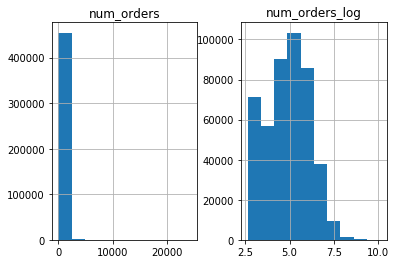

In [55]:
df_plot.hist()

In [66]:
round(df_plot.max() - df_plot.min(), 2)

num_orders        24286.00
num_orders_log        7.46
dtype: float64

In [67]:
df_plot.agg({'min', 'max', 'mean', 'std', 'median', pd.Series.mode).round(2)

SyntaxError: invalid syntax (<ipython-input-67-c1da5a4af58f>, line 1)

In [72]:
df_plot.corr()

,num_orders,num_orders_log
num_orders,1.000000,0.724093
num_orders_log,0.724093,1.000000


# num_orders vs log(num_orders)

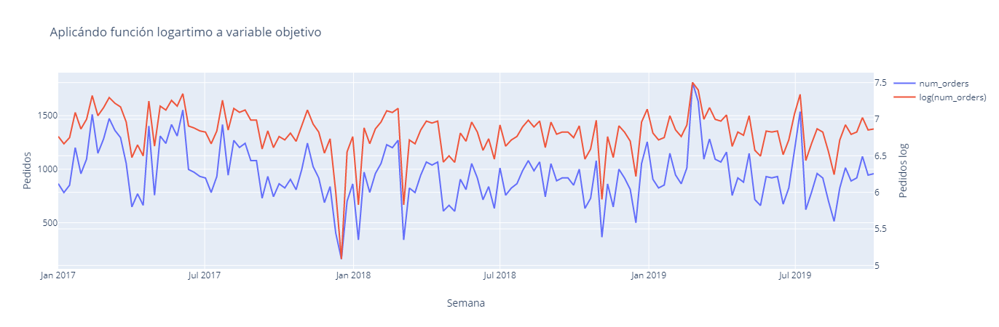

In [74]:
charts = [
	go.Scatter(
		x = df_train_processed.index,
		y = df_train_processed.num_orders,
		name = 'num_orders'
	),
	go.Scatter(
		x = df_train_processed.index,
		y = np.log1p(df_train_processed.num_orders),
		name = 'log(num_orders)',
		yaxis='y2'
	)
]

fig = go.Figure(
	data = charts,
	layout = go.Layout(
		title = 'Aplicándo función logartimo a variable objetivo',
		xaxis_title = 'Semana',
		yaxis_title = 'Pedidos',
		yaxis2 = go.YAxis(
			overlaying = 'y',
			side = 'right',
			title = 'Pedidos log'
		)
	)
)

fig

In [15]:
results_metrics = list()

## XGBoost without transformation

In [16]:
X = df_train_processed.drop(columns='num_orders')
Y = df_train_processed['num_orders']

In [17]:
# X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
split_size = len(df_train_processed)-15
X_train = X.iloc[:split_size,:]
X_test = X.iloc[split_size:,:]
Y_train =  Y.iloc[:split_size]
Y_test = Y.iloc[split_size:]

In [18]:
model_normal = xgb.XGBRegressor(
	learning_rate = 0.01,
	eval_metric ='rmse',
	n_estimators = 50000,
	max_depth = 5,
	subsample = 0.8,
	colsample_bytree = 1,
	gamma = 0.5  
 )

In [19]:
start_time = time.time()
model_normal.fit(
	X_train,
	Y_train,
	eval_metric='rmse',
	eval_set=[(X_test, Y_test)],
	early_stopping_rounds=500,
	verbose=0
)
end_time = time.time()
time_model_normal = end_time - start_time

[20:44:58] WARNING: C:/Jenkins/workspace/xgboost-win64_release_0.90/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [20]:
xgb_preds_normal = model_normal.predict(X_test)

In [21]:
mse=metrics.mean_squared_error(Y_test, xgb_preds_normal)
rmse = np.sqrt(mse)
print('RMSE: ' + str(rmse))

RMSE: 214.65458653509558


In [22]:
xgb_preds_normal = pd.DataFrame(xgb_preds_normal)
xgb_preds_normal.index = Y_test.index

In [23]:
results_metrics.append(
	{
		'model' : 'XGBoost without transformation',
		'rmse' : rmse,
		'mse' : mse,
		'time' : time_model_normal,
		'range train' : Y_train.max() - Y_train.min(),
		'range test' : Y_test.max() - Y_test.min()
	}
)

## XGBoost without transformation

In [24]:
X = df_train_processed.drop(columns='num_orders')
Y = np.log1p(df_train_processed['num_orders'])

In [25]:
# X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
split_size = len(df_train_processed)-15
X_train = X.iloc[:split_size,:]
X_test = X.iloc[split_size:,:]
Y_train =  Y.iloc[:split_size]
Y_test = Y.iloc[split_size:]

In [26]:
model_log = xgb.XGBRegressor(
	learning_rate = 0.01,
	eval_metric ='rmse',
	n_estimators = 50000,
	max_depth = 5,
	subsample = 0.8,
	colsample_bytree = 1,
	gamma = 0.5  
 )

In [27]:
start_time = time.time()
model_log.fit(
	X_train,
	Y_train,
	eval_metric='rmse',
	eval_set=[(X_test, Y_test)],
	early_stopping_rounds=500,
	verbose=0
)
end_time = time.time()
time_model_normal = end_time - start_time

[20:44:58] WARNING: C:/Jenkins/workspace/xgboost-win64_release_0.90/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [28]:
xgb_preds_log = model_log.predict(X_test)
xgb_preds_log = np.exp(xgb_preds_log)

In [29]:
range_train = Y_train.max() - Y_train.min()
range_test = Y_test.max() - Y_test.min()

In [30]:
Y_train = np.exp(Y_train)
Y_test = np.exp(Y_test)

In [31]:
mse=metrics.mean_squared_error(Y_test, xgb_preds_log)
rmse = np.sqrt(mse)
print('RMSE: ' + str(rmse))

RMSE: 234.6937513165057


In [32]:
xgb_preds_log = pd.DataFrame(xgb_preds_log)
xgb_preds_log.index = Y_test.index

In [33]:
results_metrics.append(
	{
		'model' : 'XGBoost without transformation',
		'rmse' : rmse,
		'mse' : mse,
		'time' : time_model_normal,
		'range train' : range_train,
		'range test' : range_test
	}
)

# Show results

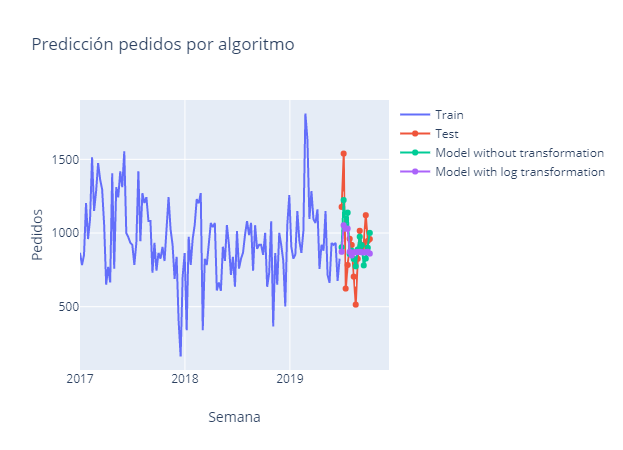

In [34]:
charts = [
	go.Scatter(
		x = Y_train.index,
		y = Y_train,
		name = 'Train'
	),
	go.Scatter(
		x = Y_test.index,
		y = Y_test,
		name = 'Test'
	),
	go.Scatter(
		x = xgb_preds_normal.index,
		y = xgb_preds_normal[0],
		name = 'Model without transformation'
	),
	go.Scatter(
		x = xgb_preds_log.index,
		y = xgb_preds_log[0],
		name = 'Model with log transformation'
	)
]

fig = go.Figure(
	data = charts,
	layout = go.Layout(
		title = 'Predicción pedidos por algoritmo',
		xaxis_title = 'Semana',
		yaxis_title = 'Pedidos'
	)
)

fig

In [35]:
pd.DataFrame.from_dict(results_metrics).sort_values('rmse')[['model', 'time', 'range train', 'range test']]

,model,time,range train,range test
0,XGBoost without transformation,0.571345,1649.000000,1025.000000
1,XGBoost without transformation,0.335134,2.414038,1.096665


In [36]:
results_metrics

[{'model': 'XGBoost without transformation',
  'rmse': 214.65458653509558,
  'mse': 46076.591520552836,
  'time': 0.571345329284668,
  'range train': 1649,
  'range test': 1025},
 {'model': 'XGBoost without transformation',
  'rmse': 234.6937513165057,
  'mse': 55081.15690701382,
  'time': 0.33513379096984863,
  'range train': 2.4140381226510295,
  'range test': 1.096664868383714}]